<a href="https://colab.research.google.com/github/Aditiuniyal/TEXT-TO-IMAGE-GENERATION-USING-STACK-GANS/blob/main/stage_2_colab_ready.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi


Mon May 19 15:05:30 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   33C    P0             48W /  400W |       0MiB /  40960MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

In [2]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [3]:
import os

# Dataset URL (direct link with `?download=1` at the end)
data_url = "https://data.caltech.edu/records/65de6-vp158/files/CUB_200_2011.tgz?download=1"

# Create data directory in Colab local storage
download_path = "/content/CUB_200_2011"
os.makedirs(download_path, exist_ok=True)

# Download using wget
!wget -O /content/CUB_200_2011.tgz "$data_url"

# Extract the dataset
!tar -xvzf /content/CUB_200_2011.tgz -C "$download_path"

# Print the contents to confirm
!ls "$download_path"


Streaming output truncated to the last 5000 lines.
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0079_113288.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0004_111989.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0068_113247.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0127_111935.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0094_112773.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0028_113217.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0126_110959.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0007_111029.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0096_111519.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0120_113001.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0010_112678.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0025_111669.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0084_111300.jpg
CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0002_112905.j

In [4]:
import os

# ✅ Updated local Colab paths after unzipping birds.zip in /content/birds
data_dir = "/content/CUB_200_2011/CUB_200_2011/"
train_dir = os.path.join(data_dir, "train")
test_dir = os.path.join(data_dir, "test")

embeddings_path_train = "/content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/train/char-CNN-RNN-embeddings.pickle"
embeddings_path_test = "/content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/test/char-CNN-RNN-embeddings.pickle"

filename_path_train = "/content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/train/filenames.pickle"
filename_path_test = "/content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/test/filenames.pickle"

class_id_path_train = "/content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/train/class_info.pickle"
class_id_path_test = "/content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/test/class_info.pickle"

# ✅ Corrected dataset path
dataset_path = "/content/CUB_200_2011/CUB_200_2011"

# 🔄 Optional: Load saved model weights from Drive
# stage1.load_model('/content/drive/MyDrive/StackGAN/models/stage1_gen.pth')
# stage2.load_model('/content/drive/MyDrive/StackGAN/models/stage2_gen.pth')


In [5]:
!pip install tensorboardX

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 2.5 MB/s eta 0:00:00


In [6]:
import torch
import numpy as np
import pandas as pd
from torchvision import transforms
import os
import numpy as np
import pandas as pd
from nltk.tokenize import RegexpTokenizer
from PIL import Image
from torchvision.utils import make_grid

import seaborn as sns
import os
import time
import random
import argparse

import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
import matplotlib
from torch.cuda.amp import GradScaler, autocast
import matplotlib.pyplot as plt
import pickle
import torch.utils.data as dataUtil
from tensorboardX import SummaryWriter
import torchvision.utils as vutils
import warnings
import scipy.misc
import errno
warnings.filterwarnings("ignore")


<ipython-input-6-b7b73c30cf4a>:29: DeprecationWarning: scipy.misc is deprecated and will be removed in 2.0.0
  import scipy.misc


In [7]:
# import os
# import numpy as np
# import pandas as pd
# from PIL import Image
# import torch
# import torch.nn as nn
# from torchvision import transforms
# import pickle
# import torch.utils.data as dataUtil

# class BirdDataset(dataUtil.Dataset):
#     def __init__(self, dataDir, split='train', imgSize=64, transform=None):
#         super(BirdDataset,self).__init__()
#         self.transform = transform
#         self.norm = transforms.Compose([
#             transforms.ToTensor(),
#             transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
#         self.imgSize = imgSize
#         self.dataDir = dataDir
#         self.filenames, self.caps = self.load_info(dataDir, split)
#         self.bbox = self.load_bbox()
#         self.classes = self.load_class(dataDir, split)

#     def load_info(self, dataDir, split):
#         filenames = self.load_filenames(dataDir, split)
#         # CORRECTED: Load caption embeddings instead of filenames
#         if split == 'train':
#             captionFile = os.path.join(dataDir, "char-CNN-RNN-embeddings.pickle")
#         elif split == 'test':
#             captionFile = os.path.join(dataDir, "char-CNN-RNN-embeddings.pickle") # Assuming test has embeddings in the same structure
#         else:
#             raise ValueError(f"Invalid split: {split}")

#         print(f'Loading captions from: {captionFile}')
#         with open (captionFile, 'rb') as f:
#             # The loaded data should be a list of caption embedding arrays
#             captions = pickle.load(f,encoding='latin1')

#         print('captions type: ', type(captions))
#         if isinstance(captions, list):
#              print(f'Number of caption lists: {len(captions)}')
#              if len(captions) > 0:
#                  print('First caption list item type: ', type(captions[0]))
#                  if isinstance(captions[0], np.ndarray):
#                       print('First caption list item shape: ', captions[0].shape)
#              else:
#                   print('Captions list is empty.')
#         else:
#             print('Captions structure unexpected. Expected a list.')


#         return filenames, captions

#     def load_filenames(self, dataDir, split):
#         # Using the correct filenames.pickle path from the previously defined variables
#         if split == 'train':
#              path = os.path.join(dataDir, "filenames.pickle")
#         elif split == 'test':
#              path = os.path.join(dataDir, "filenames.pickle") # Assuming test has filenames in the same structure
#         else:
#              raise ValueError(f"Invalid split: {split}")

#         print(f'Loading filenames from: {path}')
#         with open(path, 'rb') as f:
#             filenames = pickle.load(f,encoding='latin1')
#         print('Load filenames from: %s (%d)' % (path, len(filenames)))
#         return filenames


#     def load_bbox(self):
#         path = "/content/CUB_200_2011/CUB_200_2011/bounding_boxes.txt"
#         print(f'Loading bounding boxes from: {path}')
#         bbox_data = pd.read_csv(path, delim_whitespace=True, header=None).astype(int)

#         filepath = os.path.join("/content/CUB_200_2011/CUB_200_2011", 'images.txt')
#         print(f'Loading image filenames for bbox mapping from: {filepath}')
#         df_filenames = pd.read_csv(filepath, delim_whitespace=True, header=None)
#         filenames = sorted( list(df_filenames[1]))
#         fname_bbox_dict = {x[:-4]:[] for x in filenames} # use filename without '.jpg' extension as a key
#         # CORRECTED: Iterate and access bbox_data based on the index 'i'
#         for i in range(len(filenames)):
#             # Check if the index 'i' is within the bounds of bbox_data
#             if i < len(bbox_data):
#                 data = list(bbox_data.iloc[i][1:])
#                 k = filenames[i][:-4]
#                 fname_bbox_dict[k] = data
#             else:
#                  print(f"Warning: Index {i} out of bounds for bbox_data with length {len(bbox_data)}. Skipping bbox for {filenames[i]}.")

#         return fname_bbox_dict


#     def load_class(self, dataDir, split):
#         # Using the correct class_info.pickle path from the previously defined variables
#         if split == 'train':
#             path = os.path.join(dataDir, "class_info.pickle")
#         elif split == 'test':
#              path = os.path.join(dataDir, "class_info.pickle") # Assuming test has class_info in the same structure
#         else:
#              raise ValueError(f"Invalid split: {split}")

#         print(f'Loading class info from: {path}')
#         if os.path.isfile(path):
#             with open(path, 'rb') as f:
#                 classId = pickle.load(f,encoding='latin1')
#             if isinstance(classId, list):
#                  print(f'Load class info from: {path} ({len(classId)})')
#                  return classId
#             else:
#                  print(f"Warning: Expected class info to be a list, but got {type(classId)}. Falling back to arange.")
#                  classId = np.arange(len(self.filenames))
#                  return list(classId) # Ensure it's a list
#         else:
#             # Fallback if class_info.pickle doesn't exist
#             print(f'Warning: Class info file not found at {path}. Falling back to arange.')
#             classId = np.arange(len(self.filenames))
#             return list(classId) # Ensure it's a list


#     def get_img(self, img_path, bbox=None):
#         img = Image.open(img_path).convert('RGB')
#         width, height = img.size
#         if bbox is not None:
#             # Ensure bbox has the expected format [x, y, width, height]
#             if isinstance(bbox, list) and len(bbox) == 4:
#                 x, y, w, h = bbox
#                 # Ensure bbox values are non-negative integers
#                 x, y, w, h = int(max(0, x)), int(max(0, y)), int(max(0, w)), int(max(0, h))

#                 # Calculate crop coordinates, ensuring they are within image bounds
#                 R = int(np.maximum(w, h) * 0.75)
#                 center_x = int(x + w / 2)
#                 center_y = int(y + h / 2)

#                 y1 = int(np.maximum(0, center_y - R))
#                 y2 = int(np.minimum(height, center_y + R))
#                 x1 = int(np.maximum(0, center_x - R))
#                 x2 = int(np.minimum(width, center_x + R))

#                 # Ensure crop dimensions are positive
#                 if x2 > x1 and y2 > y1:
#                     img = img.crop([x1, y1, x2, y2])
#                 else:
#                     print(f"Warning: Invalid crop coordinates for image {img_path} based on bbox {bbox}. Skipping crop.")
#                     # If crop dimensions are invalid, don't crop
#             else:
#                  # Handle unexpected bbox format, maybe skip cropping or log a warning
#                  print(f"Warning: Unexpected bbox format for image {img_path}: {bbox}. Expected a list of 4 numbers [x, y, w, h]. Skipping crop.")
#                  pass # Or add logic to handle this case


#         load_size = int(self.imgSize * 76 / 64)
#         img = img.resize((load_size, load_size), Image.BILINEAR)
#         if self.transform is not None:
#             img = self.transform(img)
#         # Ensure image is a tensor after transformations
#         if not isinstance(img, torch.Tensor):
#              img = self.norm(img) # Apply normalization which includes ToTensor

#         return img


#     def __len__(self):
#         # Add this method to return the size of the dataset
#         return len(self.filenames)

#     def __getitem__(self, idx):
#         key = self.filenames[idx]

#         if self.bbox is not None and key in self.bbox:
#             bbox = self.bbox[key]
#         else:
#             bbox = None

#         # Get the list/array of embeddings for this image
#         # Assuming self.caps is a list where each element self.caps[idx] is a np array of shape (num_captions, embedding_dim)
#         emb_list = self.caps[idx]

#         # random select a sentence from the list/array of embeddings for this image
#         # Check if emb_list is not empty before trying to get its shape
#         if isinstance(emb_list, np.ndarray) and emb_list.shape[0] > 0:
#              sample = np.random.randint(0, emb_list.shape[0]) # Use emb_list.shape[0] for the upper bound
#              cap = emb_list[sample, :] # Select the embedding array for the chosen caption
#         elif isinstance(emb_list, list) and len(emb_list) > 0:
#              # Handle case if emb_list is a list of arrays/tensors
#              sample = np.random.randint(0, len(emb_list))
#              cap = emb_list[sample]
#         else:
#              # Handle case where there are no captions for this image or emb_list is not in expected format
#              print(f"Warning: No valid captions found for image {key} at index {idx}. Expected numpy array or list with shape[0] > 0 or length > 0. Got type {type(emb_list)} with shape/length {getattr(emb_list, 'shape', getattr(emb_list, '__len__', 'N/A')())}. Returning a zero tensor.")
#              # Return a tensor of zeros with the expected embedding dimension
#              # You need to know the expected embedding dimension. Based on the model it's 1024.
#              cap = torch.zeros(1024, dtype=torch.float32)


#         # Corrected imagePath construction based on the provided example
#         imagePath = os.path.join(self.dataDir, 'images', self.filenames[idx] + '.jpg')
#         image = self.get_img(imagePath, bbox)

#         # Ensure cap is a tensor
#         if not isinstance(cap, torch.Tensor):
#              cap = torch.from_numpy(cap).float()


#         return image, cap






class BirdDataset(dataUtil.Dataset):
    def __init__(self, dataDir, split='train', imgSize=64, transform=None):
        super(BirdDataset,self).__init__()
        self.transform = transform
        self.norm = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
        self.imgSize = imgSize
        self.split = split # Store split information

        # Use the pre-defined correct paths based on the split
        # These variables (filename_path_train, etc.) MUST be defined
        # in a cell *before* this class definition.
        global filename_path_train, filename_path_test
        global embeddings_path_train, embeddings_path_test
        global class_id_path_train, class_id_path_test
        global dataset_path # Used for image files and bounding box/images.txt

        if split == 'train':
            self.filename_path = filename_path_train
            self.caption_path = embeddings_path_train
            self.class_id_path = class_id_path_train
        elif split == 'test':
            self.filename_path = filename_path_test
            self.caption_path = embeddings_path_test
            self.class_id_path = class_id_path_test
        else:
            raise ValueError(f"Invalid split: {split}. Must be 'train' or 'test'.")

        # Load data during initialization
        self.filenames = self.load_filenames()
        self.caps = self.load_info()
        self.bbox = self.load_bbox()
        self.classes = self.load_class()


    def load_info(self):
        print(f'Loading captions from: {self.caption_path}')
        # Check if the file exists before trying to open it
        if not os.path.isfile(self.caption_path):
            raise FileNotFoundError(f"Caption file not found at: {self.caption_path}")

        try:
            with open (self.caption_path, 'rb') as f:
                # The loaded data should be a list of caption embedding arrays
                captions = pickle.load(f,encoding='latin1')
        except Exception as e:
            raise IOError(f"Error loading pickle file {self.caption_path}: {e}")


        print('captions type: ', type(captions))
        if isinstance(captions, list):
             print(f'Number of caption lists: {len(captions)}')
             if len(captions) > 0:
                 print('First caption list item type: ', type(captions[0]))
                 if isinstance(captions[0], np.ndarray):
                      print('First caption list item shape: ', captions[0].shape)
             else:
                  print('Captions list is empty.')
        else:
            print('Captions structure unexpected. Expected a list.')


        return captions

    def load_filenames(self):
        print(f'Loading filenames from: {self.filename_path}')
        # Check if the file exists before trying to open it
        if not os.path.isfile(self.filename_path):
            raise FileNotFoundError(f"Filenames file not found at: {self.filename_path}")

        try:
            with open(self.filename_path, 'rb') as f:
                filenames = pickle.load(f,encoding='latin1')
        except Exception as e:
             raise IOError(f"Error loading pickle file {self.filename_path}: {e}")


        print('Load filenames from: %s (%d)' % (self.filename_path, len(filenames)))
        return filenames


    def load_bbox(self):
        # Use the globally defined dataset_path for bounding_boxes.txt
        global dataset_path # Declare dataset_path as global

        path = os.path.join(dataset_path, "bounding_boxes.txt")
        print(f'Loading bounding boxes from: {path}')
        # Check if the file exists before trying to open it
        if not os.path.isfile(path):
            print(f"Warning: Bounding boxes file not found at: {path}. Proceeding without bounding box information.")
            return None # Return None if bounding box file is not found

        try:
            bbox_data = pd.read_csv(path, delim_whitespace=True, header=None).astype(int)
        except Exception as e:
            print(f"Error reading bounding_boxes.txt at {path}: {e}. Proceeding without bounding box information.")
            return None


        # Use the globally defined dataset_path for images.txt
        filepath = os.path.join(dataset_path, 'images.txt')
        print(f'Loading image filenames for bbox mapping from: {filepath}')
        # Check if the file exists before trying to open it
        if not os.path.isfile(filepath):
             print(f"Warning: Image filenames file for bbox mapping not found at: {filepath}. Proceeding without bounding box information.")
             return None # Return None if image filenames file is not found

        try:
            df_filenames = pd.read_csv(filepath, delim_whitespace=True, header=None)
        except Exception as e:
             print(f"Error reading images.txt at {filepath}: {e}. Proceeding without bounding box information.")
             return None

        # The filenames in images.txt include the class directory prefix, which matches the filenames in filenames.pickle
        filenames_in_images_txt = sorted( list(df_filenames[1]))

        # Create a dictionary mapping filename (without .jpg) to bbox data
        fname_bbox_dict = {}
        for i in range(len(filenames_in_images_txt)):
             # Check if the index 'i' is within the bounds of bbox_data
            if i < len(bbox_data):
                data = list(bbox_data.iloc[i][1:])
                k = filenames_in_images_txt[i][:-4] # Use filename without '.jpg' extension as a key
                fname_bbox_dict[k] = data
            else:
                 # This warning might indicate an issue with the images.txt or bbox_data files not aligning
                 print(f"Warning: Index {i} out of bounds for bbox_data with length {len(bbox_data)}. Skipping bbox for {filenames_in_images_txt[i]}.")

        return fname_bbox_dict


    def load_class(self):
        print(f'Loading class info from: {self.class_id_path}')
        if os.path.isfile(self.class_id_path):
            try:
                with open(self.class_id_path, 'rb') as f:
                    classId = pickle.load(f,encoding='latin1')
            except Exception as e:
                 print(f"Error loading pickle file {self.class_id_path}: {e}. Falling back to arange.")
                 classId = np.arange(len(self.filenames))
                 return list(classId) # Ensure it's a list


            if isinstance(classId, list):
                 print(f'Load class info from: {self.class_id_path} ({len(classId)})')
                 # Ensure the loaded classId list matches the number of filenames
                 if len(classId) != len(self.filenames):
                      print(f"Warning: Number of class IDs ({len(classId)}) does not match number of filenames ({len(self.filenames)}). Falling back to arange.")
                      classId = np.arange(len(self.filenames))
                      return list(classId)
                 return classId
            else:
                 print(f"Warning: Expected class info to be a list, but got {type(classId)}. Falling back to arange.")
                 classId = np.arange(len(self.filenames))
                 return list(classId) # Ensure it's a list
        else:
            # Fallback if class_info.pickle doesn't exist
            print(f'Warning: Class info file not found at {self.class_id_path}. Falling back to arange.')
            classId = np.arange(len(self.filenames))
            return list(classId) # Ensure it's a list


    def get_img(self, img_filename_key, bbox=None):
        # Use the globally defined dataset_path to construct the full image path.
        # The img_filename_key is expected to be like '001.Black_footed_Albatross/Black_Footed_Albatross_0001_796119'
        global dataset_path # Declare dataset_path as global

        img_path = os.path.join(dataset_path, 'images', img_filename_key + '.jpg')

        # Check if the image file exists
        if not os.path.isfile(img_path):
            print(f"Warning: Image file not found at: {img_path}. Returning a black image.")
            # Return a black image tensor of the target size if the file is not found
            return torch.zeros(3, self.imgSize, self.imgSize, dtype=torch.float32)

        try:
            img = Image.open(img_path).convert('RGB')
        except Exception as e:
            print(f"Error opening or reading image file {img_path}: {e}. Returning a black image.")
            return torch.zeros(3, self.imgSize, self.imgSize, dtype=torch.float32)


        width, height = img.size
        if bbox is not None:
            # Ensure bbox has the expected format [x, y, width, height]
            if isinstance(bbox, list) and len(bbox) == 4:
                x, y, w, h = bbox
                # Ensure bbox values are non-negative integers
                x, y, w, h = int(max(0, x)), int(max(0, y)), int(max(0, w)), int(max(0, h))

                # Calculate crop coordinates, ensuring they are within image bounds
                R = int(np.maximum(w, h) * 0.75)
                center_x = int(x + w / 2)
                center_y = int(y + h / 2)

                y1 = int(np.maximum(0, center_y - R))
                y2 = int(np.minimum(height, center_y + R))
                x1 = int(np.maximum(0, center_x - R))
                x2 = int(np.minimum(width, center_x + R))

                # Ensure crop dimensions are positive and within image bounds
                if x2 > x1 and y2 > y1 and x1 >= 0 and y1 >= 0 and x2 <= width and y2 <= height:
                    try:
                        img = img.crop([x1, y1, x2, y2])
                    except Exception as e:
                        print(f"Error cropping image {img_path} with bbox {bbox}: {e}. Skipping crop.")
                        # If crop fails, don't crop
                else:
                    print(f"Warning: Invalid or out-of-bounds crop coordinates for image {img_path} based on bbox {bbox} and image size ({width}, {height}). Skipping crop.")
                    # If crop dimensions are invalid, don't crop
            else:
                 # Handle unexpected bbox format, maybe skip cropping or log a warning
                 print(f"Warning: Unexpected bbox format for image {img_path}: {bbox}. Expected a list of 4 numbers [x, y, w, h]. Skipping crop.")
                 pass # Or add logic to handle this case


        load_size = int(self.imgSize * 76 / 64)
        try:
            img = img.resize((load_size, load_size), Image.BILINEAR)
        except Exception as e:
             print(f"Error resizing image {img_path} to ({load_size}, {load_size}): {e}. Returning a black image.")
             return torch.zeros(3, self.imgSize, self.imgSize, dtype=torch.float32)


        if self.transform is not None:
            try:
                img = self.transform(img)
            except Exception as e:
                 print(f"Error applying transform to image {img_path}: {e}. Returning a black image after resize.")
                 # If transform fails after resize, apply default norm/ToTensor
                 if not isinstance(img, torch.Tensor):
                     img = self.norm(img)
                 return img


        # Ensure image is a tensor after transformations
        if not isinstance(img, torch.Tensor):
             img = self.norm(img) # Apply normalization which includes ToTensor

        return img


    def __len__(self):
        return len(self.filenames)

    def __getitem__(self, idx):
        # Ensure idx is within the bounds of filenames
        if idx >= len(self.filenames):
             raise IndexError(f"Index {idx} is out of bounds for dataset with size {len(self.filenames)}")

        key = self.filenames[idx]

        if self.bbox is not None and key in self.bbox:
            bbox = self.bbox[key]
        else:
            bbox = None

        # Get the list/array of embeddings for this image
        # Assuming self.caps is a list where each element self.caps[idx] is a np array of shape (num_captions, embedding_dim)
        # Check if idx is within the bounds of self.caps
        if idx < len(self.caps):
             emb_list = self.caps[idx]
        else:
             # This should ideally not happen if filenames and captions are loaded correctly and have the same length
             print(f"Warning: Caption embeddings not found for index {idx}. Number of captions loaded: {len(self.caps)}. Number of filenames loaded: {len(self.filenames)}. Returning a zero tensor for caption.")
             # Return a zero tensor with the expected embedding dimension (1024)
             cap = torch.zeros(1024, dtype=torch.float32)
             # If we return a zero tensor, we should also skip processing the rest of the item
             # or handle the case where emb_list is empty/None.
             # For simplicity, let's ensure emb_list is at least an empty list if index is out of bounds.
             emb_list = []


        # random select a sentence from the list/array of embeddings for this image
        # Check if emb_list is not empty before trying to get its shape
        if isinstance(emb_list, np.ndarray) and emb_list.shape[0] > 0:
             sample = np.random.randint(0, emb_list.shape[0]) # Use emb_list.shape[0] for the upper bound
             cap = emb_list[sample, :] # Select the embedding array for the chosen caption
        elif isinstance(emb_list, list) and len(emb_list) > 0:
             # Handle case if emb_list is a list of arrays/tensors
             sample = np.random.randint(0, len(emb_list))
             cap = emb_list[sample]
        else:
             # This case is already handled if idx was out of bounds for self.caps,
             # but we keep it for robustness if emb_list is empty or not in expected format
             # even if idx is within bounds.
             # You should check if self.caps was loaded correctly if this warning appears frequently.
             # print(f"Warning: No valid captions found for image {key} at index {idx} (after loading). Expected numpy array or list with shape[0] > 0 or length > 0. Got type {type(emb_list)} with shape/length {getattr(emb_list, 'shape', getattr(emb_list, '__len__', 'N/A')())}. Returning a zero tensor.")
             # Return a tensor of zeros with the expected embedding dimension
             cap = torch.zeros(1024, dtype=torch.float32)


        # Get the image using the filename key
        image = self.get_img(key, bbox)

        # Ensure cap is a tensor
        if not isinstance(cap, torch.Tensor):
             # Convert numpy array to torch tensor
             cap = torch.from_numpy(cap).float()


        return image, cap

In [8]:

class G_Stage1(nn.Module):
    def __init__(self):
        super(G_Stage1, self).__init__()
        self.CA = CondAugment_Model()
        self.fc = nn.Sequential(
            nn.Linear(in_features=228, out_features=128*8*4*4, bias=False),
            nn.BatchNorm1d(128*8*4*4),
            nn.ReLU(inplace=True)
        )
        self.img = nn.Sequential(
            Upblock(128*8,64*8),
            Upblock(64*8,32*8),
            Upblock(32*8,16*8),
            Upblock(16*8,8*8),
            Conv_k3(8*8, 3),
            nn.Tanh()
        )

    def forward(self, noise, emb):
        cond, mean, sigma = self.CA(emb)
        cond = cond.view(noise.size(0), cond_dim, 1, 1)
        x = torch.cat((noise, cond),1)
        x = x.view(-1, 228)
        o = self.fc(x)
        h_code = o.view(-1, 128*8, 4, 4)
        fake_img = self.img(h_code)
        return fake_img, mean, sigma





In [9]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

CUDA = True
cond_dim = 128
df_dim = 128
gf_dim = 128
z_dim = 100
emb_dim = 1024

def Conv_k3(in_p, out_p, stride=1):
    return nn.Conv2d(in_p, out_p, kernel_size=3, stride=stride, padding=1, bias=False)

class Upblock(nn.Module):
    def __init__(self, inp, outp):
        super(Upblock, self).__init__()
        self.up = nn.Upsample(scale_factor=2, mode='nearest')
        self.conv = Conv_k3(inp, outp)
        self.batch = nn.BatchNorm2d(outp)
        self.relu = nn.ReLU(True)

    def forward(self, x):
        o = self.up(x)
        o = self.relu(self.conv(o))
        o = self.batch(o)
        return o

class D_output(nn.Module):
    def __init__(self, have_cond = True):
        super(D_output, self).__init__()
        self.have_cond = have_cond
        self.classifier = nn.Sequential(
            nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=4, stride=4),
            nn.Sigmoid()
        )
        if have_cond:
            cond_part = nn.Sequential(
                Conv_k3(in_p=1024+128, out_p=1024),
                nn.BatchNorm2d(1024),
                nn.LeakyReLU(0.2, inplace=True),
            )
            self.classifier = torch.nn.Sequential(*(list(cond_part)+list(self.classifier)))
        print(self.classifier)

    def forward(self, encoded_image, encoded_cond=None):
        if self.have_cond and encoded_cond is not None:
            cond = encoded_cond.view(-1, 128 , 1, 1)
            cond = cond.repeat(1, 1, 4, 4)
            image_with_cond = torch.cat((encoded_image, cond), 1)
        else:
            image_with_cond = encoded_image
        return self.classifier(image_with_cond).view(-1)

class CondAugment_Model(nn.Module):
    def __init__(self):
        super(CondAugment_Model,self).__init__()
        self.fc = nn.Linear(in_features=emb_dim, out_features=cond_dim*2)
        self.relu = nn.ReLU(True)

    def convert(self, embed):
        x = self.relu(self.fc(embed))
        mean, sigma = x[:, : cond_dim], x[:, cond_dim:]
        return mean, sigma

    def forward(self, x):
        mean, sigma = self.convert(x)
        diag = torch.exp(sigma*0.5)
        if CUDA:
            normal_dis = (torch.FloatTensor(diag.size()).normal_()).cuda()
        else:
            normal_dis = (torch.FloatTensor(diag.size()).normal_())
        condition = (diag*normal_dis)+mean
        return condition, mean, sigma

In [10]:
def KL_loss(mean, sigma):
        temp = 1+sigma+((-1)*((mean*mean)+sigma))
        return torch.mean(temp)*(-0.5)

def cal_G_loss(netD, fake_imgs, real_labels, cond):
    criterion = nn.BCELoss()
    cond = cond.detach()
    fake_f = netD(fake_imgs)

    fake_cond_ouput = netD.condition_classifier(fake_f, cond)
    errD_fake = criterion(fake_cond_ouput, real_labels)
    if netD.uncondition_classifier is not None:
        fake_uncond_output = netD.uncondition_classifier(fake_f)
        uncond_errD_fake = criterion(fake_uncond_output, real_labels)
        errD_fake += uncond_errD_fake
    return errD_fake

def cal_D_loss(netD, real_imgs, fake_imgs, real_labels, fake_labels, cond):
    criterion = nn.BCELoss()
    batch_size = real_imgs.size(0)
    cond = cond.detach()
    fake = fake_imgs.detach()

    real_img_feature = netD(real_imgs)
    fake_img_feature = netD(fake)

    real_output = netD.condition_classifier(real_img_feature, cond)
    errD_real  = criterion(real_output, real_labels)
    wrong_output = netD.condition_classifier(real_img_feature[:(batch_size-1)], cond[1:])
    errD_wrong = criterion(wrong_output, fake_labels[1:])

    fake_output = netD.condition_classifier(fake_img_feature, cond)
    errD_fake= criterion(fake_output, fake_labels)

    if netD.uncondition_classifier is not None:
        real_uncond_output = netD.uncondition_classifier(real_img_feature)
        errD_real_uncond = criterion(real_uncond_output, real_labels)

        fake_uncond_output = netD.uncondition_classifier(fake_img_feature)
        errD_fake_uncond = criterion(fake_uncond_output, fake_labels)

        errD = (errD_real+errD_real_uncond)/2. + (errD_fake+errD_wrong+errD_fake_uncond)/3.
        errD_real =  (errD_real+errD_real_uncond)/2
        errD_fake = (errD_fake+errD_fake_uncond)/2.
    else:
        errD = errD_real + (errD_fake+errD_wrong)*0.5
    return errD, errD_real.item(), errD_wrong.item(), errD_fake.item()

In [11]:
class ResBlock(nn.Module):
    def __init__(self, plane):
        super(ResBlock, self).__init__()
        self.block = nn.Sequential(
            Conv_k3(plane, plane),
            nn.BatchNorm2d(plane),
            nn.ReLU(True),
            Conv_k3(plane, plane),
            nn.BatchNorm2d(plane)
        )
        self.relu = nn.ReLU(True)

    def forward(self, x):
        tmp = x
        o = self.block(x)
        o = o + tmp
        return self.relu(o)

class G_Stage2(nn.Module):
    def __init__(self, G_Stage1):
        super(G_Stage2, self).__init__()
        self.G1 = G_Stage1
        self.CA = CondAugment_Model()
        for p in self.G1.parameters():
            p.requires_grad = False
        self.encoder = nn.Sequential(
            Conv_k3(3, 128),
            nn.ReLU(True),
            nn.Conv2d(128, 128 * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128 * 2),
            nn.ReLU(True),
            nn.Conv2d(128 * 2, 128 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128 * 4),
            nn.ReLU(True))
        self.combine = nn.Sequential(
            Conv_k3(640, 512),
            nn.BatchNorm2d(512),
            nn.ReLU(True)
        )
        self.residual = nn.Sequential(
            ResBlock(512),
            ResBlock(512),
            ResBlock(512),
            ResBlock(512)
        )
        self.decoder = nn.Sequential(
            Upblock(512,256),
            Upblock(256,128),
            Upblock(128,64),
            Upblock(64,32),
            Conv_k3(32,3),
            nn.Tanh()
        )

    def forward(self, noise, emb):
        init_image, _, _ = self.G1(noise, emb)
        encoded = self.encoder(init_image)

        cond, m, s = self.CA(emb)
        cond = cond.view(-1, 128, 1, 1)
        cond = cond.repeat(1, 1, 16, 16)

        encoded_cond = torch.cat([encoded, cond],1)
        img_feature = self.combine(encoded_cond)
        img_feature = self.residual(img_feature)
        img = self.decoder(img_feature)

        return init_image, img, m, s

In [12]:
class D_Stage2(nn.Module):
    def __init__(self):
        super(D_Stage2, self).__init__()
        self.img_encoder = nn.Sequential(
            # start 3 x 256 x 256
            nn.Conv2d(3, 128, 4, 2, 1, bias=False), #=> 128 x 128 x 128
            nn.LeakyReLU(0.2, True),

            nn.Conv2d(128, 256, 4, 2, 1, bias=False), #=> 256 x 64 x 64
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, True),

            nn.Conv2d(256, 512, 4, 2, 1, bias=False), #=> 512 x 32 x 32
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, True),

            nn.Conv2d(512, 1024, 4, 2, 1, bias=False), #=> 1024 x 16 x 16
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2, True),

            nn.Conv2d(1024, 2048, 4, 2, 1, bias=False), #=> 2048 x 8 x 8
            nn.BatchNorm2d(2048),
            nn.LeakyReLU(0.2, True),

            nn.Conv2d(2048, 4096, 4, 2, 1, bias=False), #=> 4096 x 4 x 4
            nn.BatchNorm2d(4096),
            nn.LeakyReLU(0.2, True),

            Conv_k3(4096, 2048), # 2048 x 4 x 4
            nn.BatchNorm2d(2048),
            nn.LeakyReLU(0.2, True),
            Conv_k3(2048, 1024), # 1024 x 4 x 4
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2, True)
        )

        self.condition_classifier = D_output()
        self.uncondition_classifier = D_output(have_cond=False)

    def forward(self, img):
        img_feature = self.img_encoder(img)
        return img_feature

Loading filenames from: /content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/train/filenames.pickle
Load filenames from: /content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/train/filenames.pickle (8855)
Loading captions from: /content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/train/char-CNN-RNN-embeddings.pickle
captions type:  <class 'list'>
Number of caption lists: 8855
First caption list item type:  <class 'numpy.ndarray'>
First caption list item shape:  (10, 1024)
Loading bounding boxes from: /content/CUB_200_2011/CUB_200_2011/bounding_boxes.txt
Loading image filenames for bbox mapping from: /content/CUB_200_2011/CUB_200_2011/images.txt
Loading class info from: /content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/train/class_info.pickle
Load class info from: /content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds/train/class_info.pickle (8855)
Sequential(
  (0): Conv2d(1152, 1024, kernel_size=

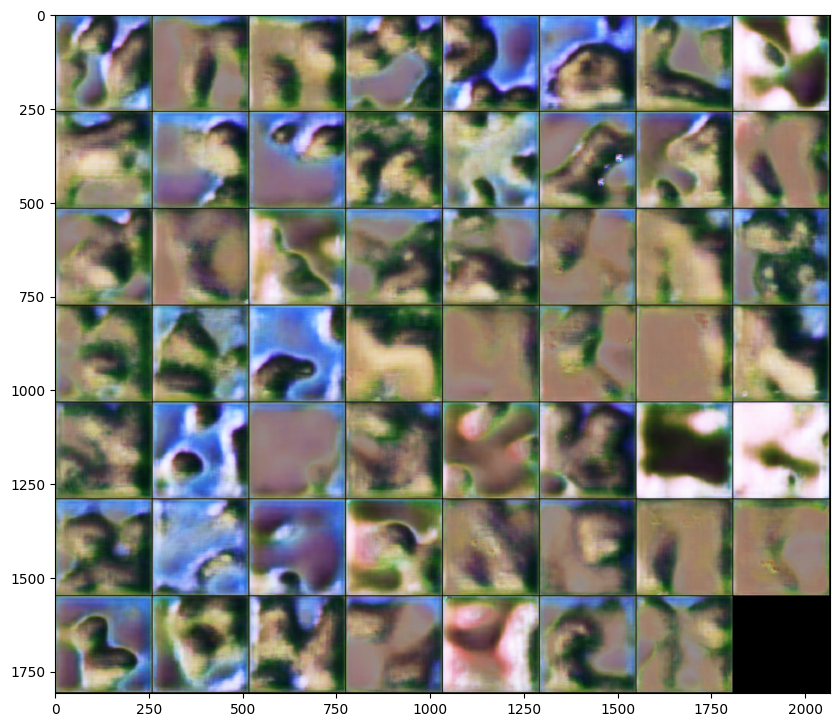

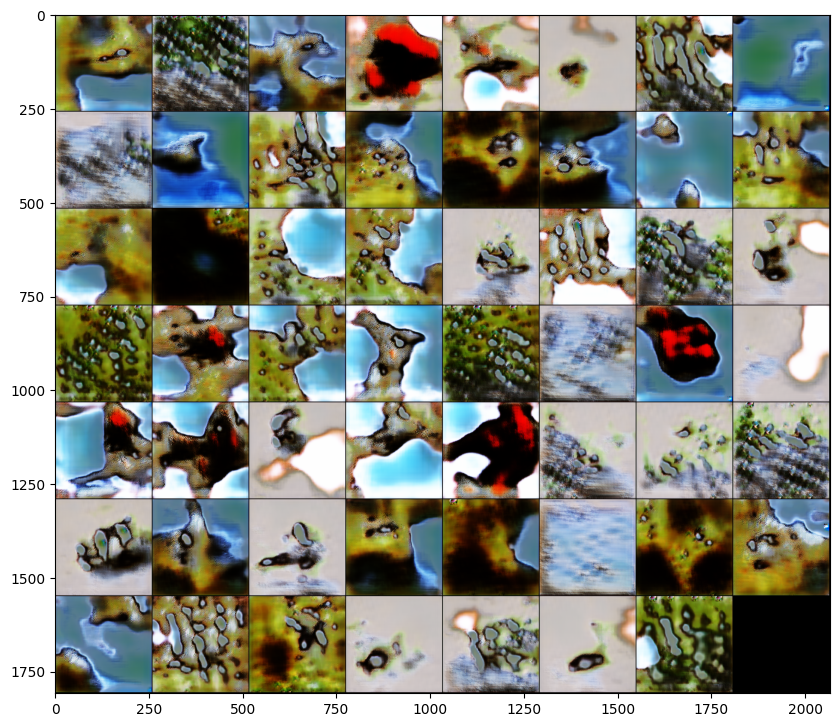

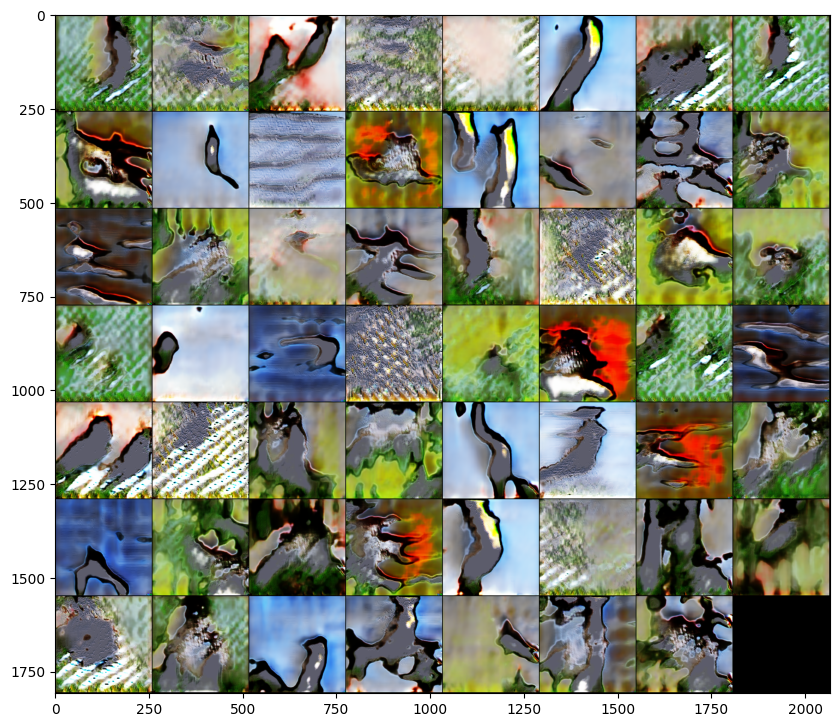

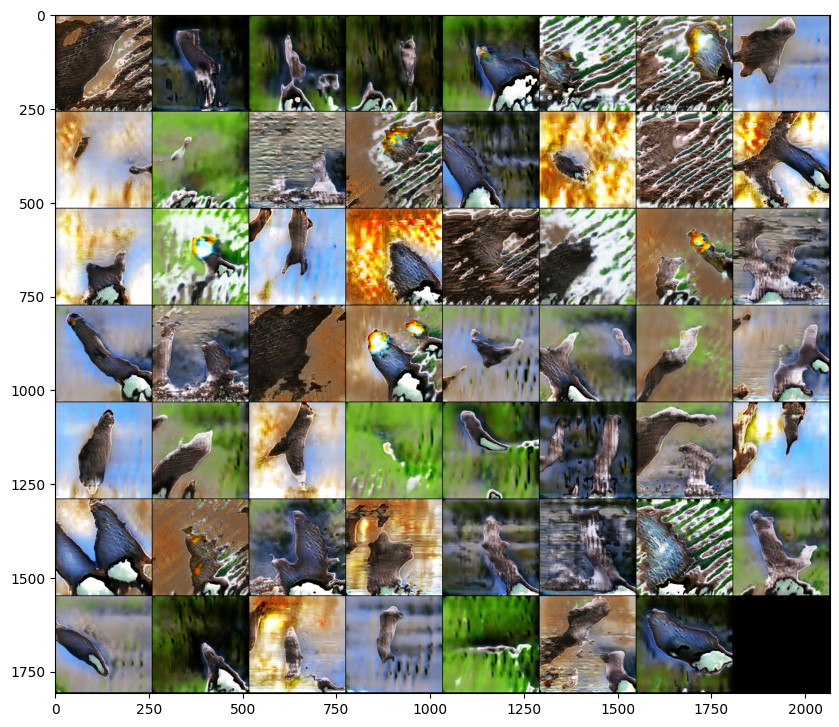

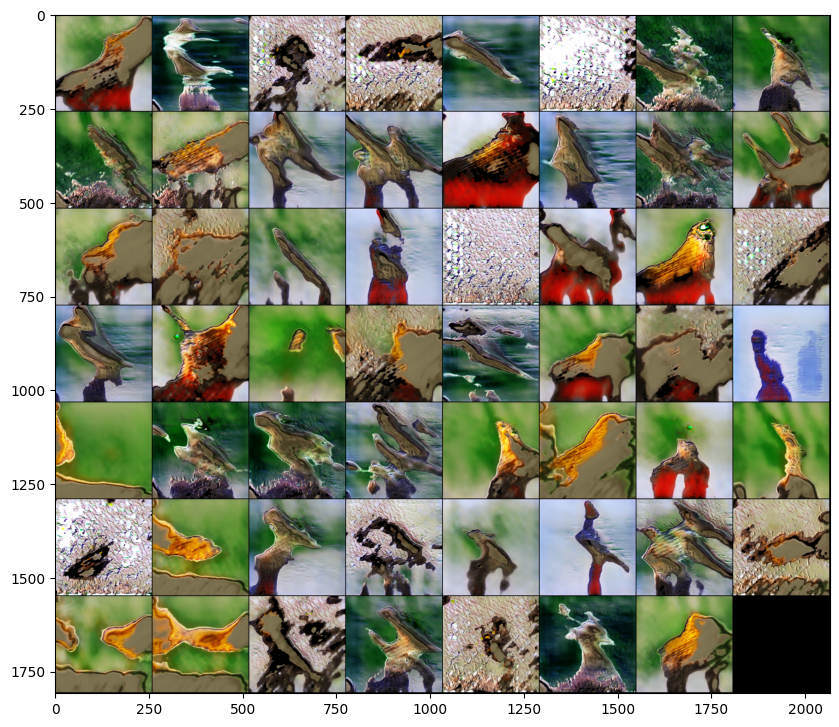

...

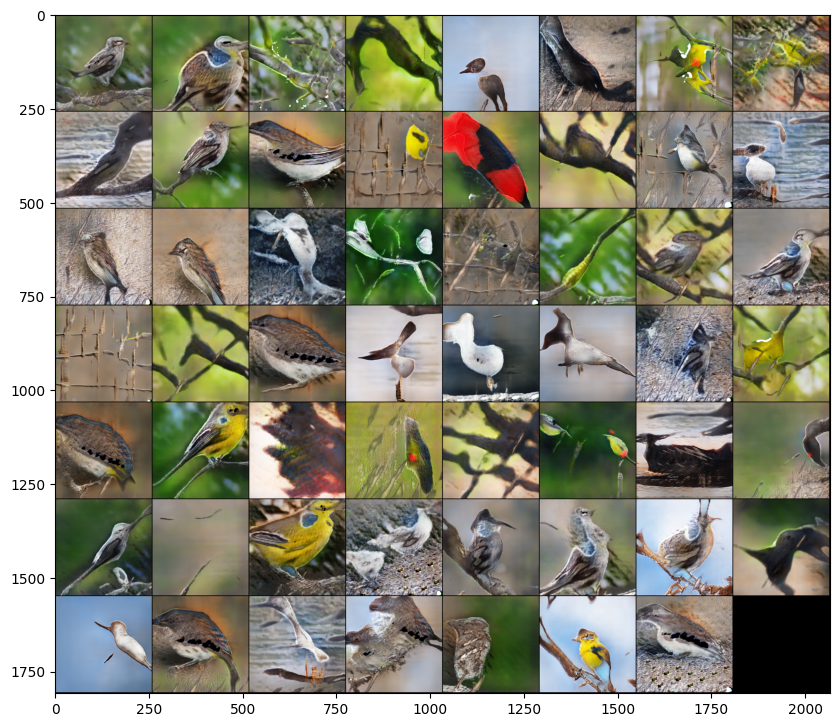

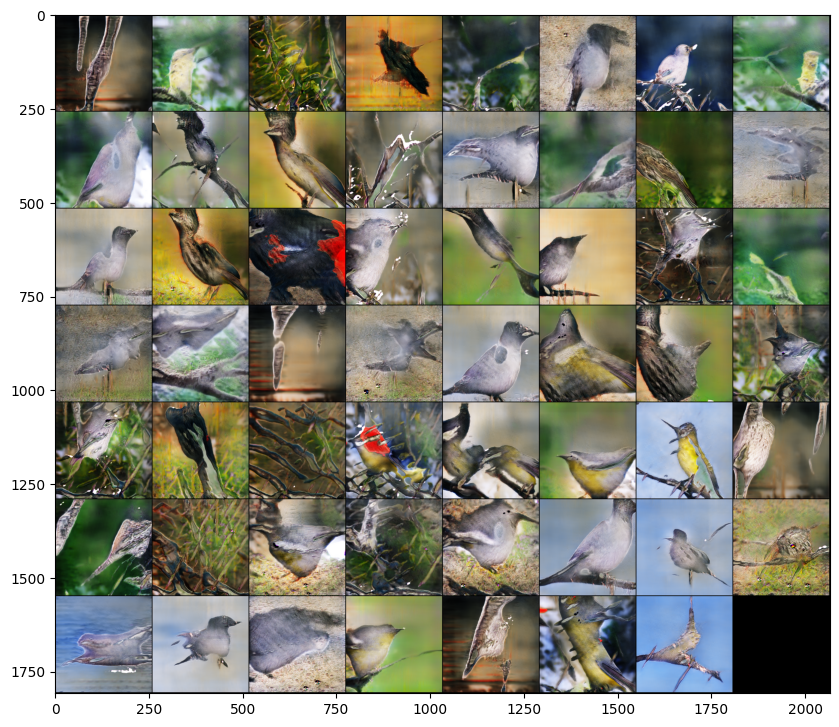

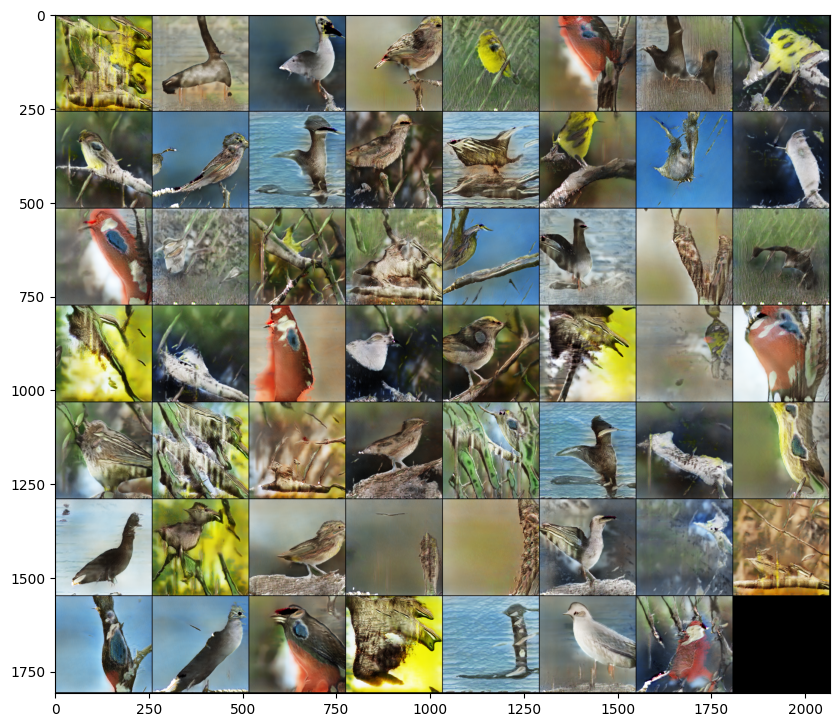

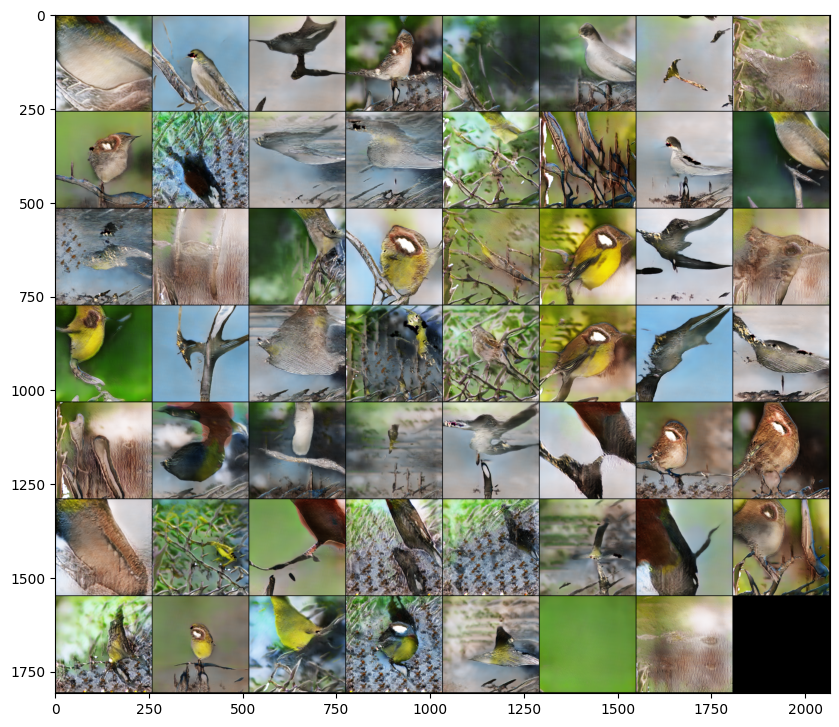

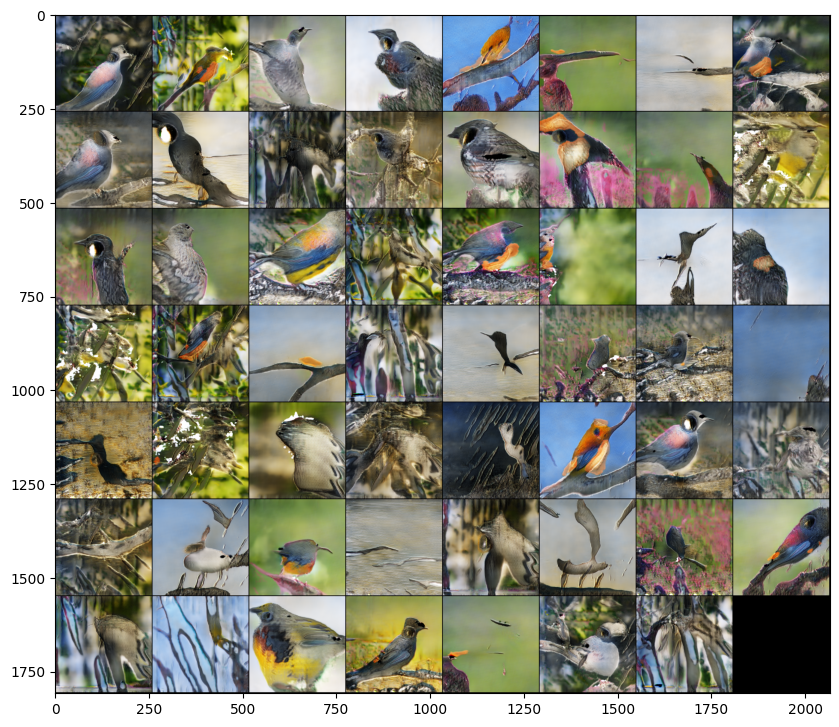

In [13]:
def main():
    device = torch.device('cuda:0')
    # load dataset with size 256x256
    batch_size = 55
    transform = transforms.Compose([
                transforms.RandomCrop(256),
                transforms.RandomHorizontalFlip(),
                transforms.ToTensor(),
                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

    writer = SummaryWriter('runs/Stage-II')

    dataset = BirdDataset(dataDir='/content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /birds', split='train', transform=transform, imgSize=256)

    tr_loader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True)
    # # Load Stage-I generator and put it into Stage-II generator
    # G1 = G_Stage1()
    # G1.load_state_dict(torch.load('/kaggle/input/stage-1-saved-models/result-1/netG_epoch_600.pth', map_location="cpu"))
    # G1.eval()




    # Load Stage-I generator and use GPU
    G1 = G_Stage1()
    G1.load_state_dict(torch.load('/content/drive/MyDrive/result-1/netG_epoch_200.pth'))  # remove map_location
    G1 = G1.cuda()  # Move model to GPU
    G1.eval()       # Set model to evaluation mode




    netG = G_Stage2(G1).to(device)
    netG.apply(weights_init)
    netD = D_Stage2().to(device)
    netD.apply(weights_init)

    lr = 0.0002
    optD = optim.Adam(netD.parameters(), lr=lr, betas=(0.5, 0.999))
    netG_param = [p for p in netG.parameters() if p.requires_grad]
    optG = optim.Adam(netG_param, lr=lr, betas=(0.5, 0.999))

    fixed_noise = torch.rand(batch_size, 100, 1, 1).to(device)

    real_labels = torch.FloatTensor(batch_size).fill_(1).to(device)
    fake_labels = torch.FloatTensor(batch_size).fill_(0).to(device)

    # Ensure 'results2/' directory exists
    imageDir = '/content/drive/MyDrive/TEXT TO IMAGE GENERATION USING STACK GAN /RESULTS/RESULTS_STAGE_2'
    os.makedirs(imageDir, exist_ok=True)

    num_epoch = 200  # 450
    iters = 0
    for epoch in range(num_epoch + 1):
        if epoch % 100 == 0 and epoch > 0:
            lr *= 0.5
            for param_group in optG.param_groups:
                param_group['lr'] = lr
            for param_group in optD.param_groups:
                param_group['lr'] = lr

        for i, data in enumerate(tr_loader, 0):
            real_imgs, encoded_caps = data
            real_imgs = real_imgs.to(device)
            encoded_caps = encoded_caps.to(device)

            # Update discriminator
            netD.zero_grad()
            noise = torch.rand(batch_size, 100, 1, 1).to(device)
            init_img, fake_imgs, m, s = netG(noise, encoded_caps)
            errD, errD_real, errD_wrong, errD_fake = cal_D_loss(netD, real_imgs, fake_imgs, real_labels, fake_labels, m)
            errD.backward()
            optD.step()

            # Update generator
            netG.zero_grad()
            errG = cal_G_loss(netD, fake_imgs, real_labels, m)
            errG += KL_loss(m, s)
            errG.backward()
            optG.step()

            writer.add_scalar("gen_loss", errG, epoch)
            writer.add_scalar("disc_loss", errD, epoch)

            if i % 50 == 0:
                print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tLoss_D_R: %.4f\tLoss_D_W: %.4f\tLoss_D_F %.4f'
                      % (epoch, num_epoch, i, len(tr_loader),
                         errD.item(), errG.item(), errD_real, errD_wrong, errD_fake))

        if epoch % 10 == 0:
            with torch.no_grad():
                _, fake, _, _ = netG(fixed_noise, encoded_caps)
                fig = plt.figure(figsize=(10, 10))
                grid = make_grid(fake.detach().cpu(), nrow=8, normalize=True).permute(1, 2, 0).numpy()
                plt.imshow(grid)
                writer.add_image("fake", vutils.make_grid(fake[:64], normalize=True), epoch)
                fig.savefig(f'{imageDir}/epch-{epoch}.png')

        if epoch % 5 == 0:
            torch.save(netG.state_dict(), f'{imageDir}/netG2_epoch_{epoch}.pth')

    torch.save(netD.state_dict(), f'{imageDir}/netD2_epoch_last.pth')

if __name__ == '__main__':
    main()


In [15]:
print("Stage 2 training complete  ")

Stage 2 training complete  
